In [3]:
from sqlalchemy import create_engine, Column, Integer, String, Text, inspect
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker
import pandas as pd
import spacy

# Load Spacy model
nlp = spacy.load("en_core_web_sm")

# Database setup
DATABASE_URL = "sqlite:///news_analysis.db"
Base = declarative_base()

class NewsArticle(Base):
    __tablename__ = 'news_articles'
    id = Column(Integer, primary_key=True)
    text = Column(Text)
    sentiment = Column(String)
    relevance = Column(String)
    source = Column(String)

engine = create_engine(DATABASE_URL)
Base.metadata.create_all(engine)
Session = sessionmaker(bind=engine)
session = Session()

# Function to load keywords
def load_keywords(file_path):
    keywords = {}
    with open(file_path, 'r') as f:
        for line in f:
            category, words = line.split(':')
            keywords[category.strip()] = [word.strip() for word in words.split(',')]
    return keywords

keywords = load_keywords('keywords.txt')

# Function to perform sentiment analysis
def analyze_sentiment(text):
    doc = nlp(text)
    positive_words = ["good", "great", "excellent", "positive", "beneficial", "fortunate"]
    negative_words = ["bad", "terrible", "poor", "negative", "unfortunate", "detrimental"]
    
    positive_count = sum([1 for token in doc if token.text.lower() in positive_words])
    negative_count = sum([1 for token in doc if token.text.lower() in negative_words])
    
    if positive_count > negative_count:
        return 'positive'
    elif negative_count > positive_count:
        return 'negative'
    else:
        return 'neutral'

# Function to check relevance
def is_relevant(text):
    for category, words in keywords.items():
        if any(word.lower() in text.lower() for word in words):
            return category
    return 'not relevant'

# Read CSV and analyze sentiment
df = pd.read_csv('news_text_data.csv')

# Debug: Print first few rows to ensure data is read correctly
print(df.head())

for index, row in df.iterrows():
    text = str(row['text'])
    
    # Debug: Print the text being analyzed
    print(f"Analyzing text: {text}")
    
    sentiment = analyze_sentiment(text)
    
    # Debug: Print the sentiment result
    print(f"Sentiment: {sentiment}")
    
    relevance = is_relevant(text)
    
    # Debug: Print the relevance result
    print(f"Relevance: {relevance}")
    
    news_article = NewsArticle(text=text, sentiment=sentiment, relevance=relevance)
    session.add(news_article)
    session.commit()
    print("Data stored in database.")

# Verify the database structure
inspector = inspect(engine)
tables = inspector.get_table_names()
print("Tables in the database:", tables)

if 'news_articles' in tables:
    columns = inspector.get_columns('news_articles')
    print("Columns in the NewsArticles table:", columns)
else:
    print("NewsArticles table does not exist in the database.")

# Query the data and print to verify storage
articles = session.query(NewsArticle).all()
print("Stored News Articles:")
for article in articles:
    print(f"Text: {article.text}, Sentiment: {article.sentiment}, Relevance: {article.relevance}, Source: {article.source}")

# Custom sentiment analysis for specific entities
def custom_sentiment_analysis(entity_name, source=None):
    if source:
        articles = session.query(NewsArticle).filter(NewsArticle.relevance != 'not relevant', NewsArticle.source == source).all()
    else:
        articles = session.query(NewsArticle).filter(NewsArticle.relevance != 'not relevant').all()

    relevant_articles = [article for article in articles if entity_name.lower() in article.text.lower()]
    positive, negative, neutral = 0, 0, 0
    for article in relevant_articles:
        if article.sentiment == 'positive':
            positive += 1
        elif article.sentiment == 'negative':
            negative += 1
        else:
            neutral += 1
    return {
        'entity': entity_name,
        'positive': positive,
        'negative': negative,
        'neutral': neutral,
        'total': len(relevant_articles)
    }

# Analyze sentiment for specific entities and sources
entities = ['politics', 'economy', 'health', 'movie']
sources = ['times of india', 'odisha tv', 'hindustan times']

for source in sources:
    print(f"\nSentiment analysis for source: {source}")
    for entity in entities:
        analysis_result = custom_sentiment_analysis(entity, source)
        print(f"Sentiment analysis for {entity}:")
        print(f"Positive: {analysis_result['positive']}")
        print(f"Negative: {analysis_result['negative']}")
        print(f"Neutral: {analysis_result['neutral']}")

# Analyze sentiment for all sources combined
print("\nSentiment analysis for all sources combined")
for entity in entities:
    analysis_result = custom_sentiment_analysis(entity)
    print(f"Sentiment analysis for {entity}:")
    print(f"Positive: {analysis_result['positive']}")
    print(f"Negative: {analysis_result['negative']}")
    print(f"Neutral: {analysis_result['neutral']}")


C:\Users\ADMIN\AppData\Local\Temp\ipykernel_20336\543057058.py:12: MovedIn20Warning: The ``declarative_base()`` function is now available as sqlalchemy.orm.declarative_base(). (deprecated since: 2.0) (Background on SQLAlchemy 2.0 at: https://sqlalche.me/e/b8d9)
  Base = declarative_base()


                                                text
0  If you enjoy diving into a world of epic battl...
1  Kooki's journey urges viewers to understand th...
2  The overall message of 'Sharmaajee Ki Beti' is...
3  ‘Rautu Ka Raaz’ is a slow-moving murder myster...
4  'A Quiet Place: Day One' is a visually stunnin...
Analyzing text: If you enjoy diving into a world of epic battles between Gods, good, and evil, then 'Kalki 2898 AD' offers quite a satisfying audio-visual experience, even though it may require some patience.
Sentiment: positive
Relevance: not relevant
Data stored in database.
Analyzing text: Kooki's journey urges viewers to understand that justice isn't always healing, and the fight for true safety continues.
Sentiment: neutral
Relevance: not relevant
Data stored in database.
Analyzing text: The overall message of 'Sharmaajee Ki Beti' is not to provide happy endings or instantly break age-old notions but to remind viewers to love, respect, and treat women equally and deser

In [7]:
import csv
import spacy
from sqlalchemy import create_engine, Column, Integer, String, Text
from sqlalchemy.ext.declarative import declarative_base
from sqlalchemy.orm import sessionmaker
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np


In [8]:
from sqlalchemy import create_engine, Table, MetaData
import pandas as pd

# Create a SQLite engine
engine = create_engine('sqlite:///news_analysis.db')

# Reflect the database tables
metadata = MetaData()
metadata.reflect(bind=engine)
analysis_table = Table('news_articles', metadata, autoload=True, autoload_with=engine)

# Fetch the data from the database
with engine.connect() as connection:
    result = connection.execute(analysis_table.select())
    df_db = pd.DataFrame(result.fetchall(), columns=result.keys())

print(df_db)


            id                                               text sentiment  \
0            1  If you enjoy diving into a world of epic battl...  negative   
1            2  Kooki's journey urges viewers to understand th...  negative   
2            3  The overall message of 'Sharmaajee Ki Beti' is...  negative   
3            4  ‘Rautu Ka Raaz’ is a slow-moving murder myster...  negative   
4            5  'A Quiet Place: Day One' is a visually stunnin...  negative   
...        ...                                                ...       ...   
121408  121409  “Today is July 1. We hope the government will ...   neutral   
121409  121410  In response to the BJD’s statement, BJP state ...   neutral   
121410  121411  The state government will implement it after t...   neutral   
121411  121412  Join and get latest news update delivered to y...   neutral   
121412  121413  Copyright © 2024 - Odisha Television Limited A...   neutral   

           relevance source  
0       not relevant 

In [9]:
# Aggregate the sentiment data for specific entities
entities = ['politics', 'education', 'health','movie']

data_db = []
for entity in entities:
    entity_data = df_db[df_db['text'].str.contains(entity, case=False)]
    positive_count = len(entity_data[entity_data['sentiment'] == 'positive'])
    negative_count = len(entity_data[entity_data['sentiment'] == 'negative'])
    neutral_count = len(entity_data[entity_data['sentiment'] == 'neutral'])
    data_db.append([entity, positive_count, negative_count, neutral_count])

df_aggregated = pd.DataFrame(data_db, columns=['entity', 'positive', 'negative', 'neutral'])
print(df_aggregated)

      entity  positive  negative  neutral
0   politics        12       172      246
1  education        24       250      336
2     health        96      1056     1458
3      movie        30       304      396


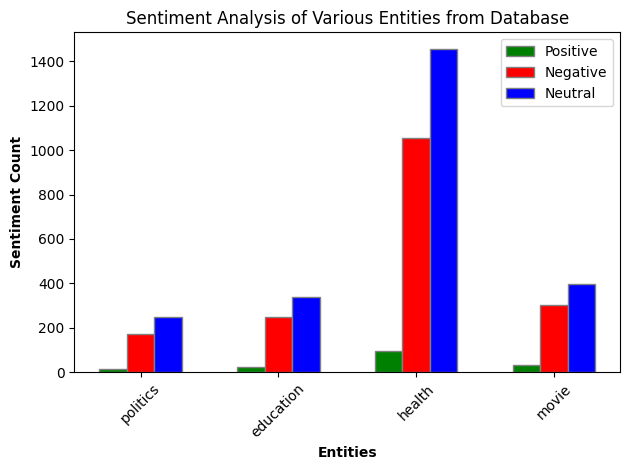

In [10]:
import matplotlib.pyplot as plt

# Define bar width and positions
bar_width = 0.2
r1 = range(len(df_aggregated))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Plot bars
plt.bar(r1, df_aggregated['positive'], color='g', width=bar_width, edgecolor='grey', label='Positive')
plt.bar(r2, df_aggregated['negative'], color='r', width=bar_width, edgecolor='grey', label='Negative')
plt.bar(r3, df_aggregated['neutral'], color='b', width=bar_width, edgecolor='grey', label='Neutral')

# Add labels
plt.xlabel('Entities', fontweight='bold')
plt.ylabel('Sentiment Count', fontweight='bold')
plt.xticks([r + bar_width for r in range(len(df_aggregated))], df_aggregated['entity'], rotation=45)
plt.title('Sentiment Analysis of Various Entities from Database')
# Add legend
plt.legend()

# Show plot
plt.tight_layout()
plt.show()